<a href="https://colab.research.google.com/github/Hardik0175/Graph_Mining/blob/main/Hardik_Sharma_Assignment_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [9]:
## location of the GED code
GED='Comparing_Graph_Embeddings/GED'
abcd_path = '/content/gdrive/MyDrive/Datasets/ABCDMaster/utils/'

datadir='/content/gdrive/MyDrive/Datasets/'
## for loading dataset from google drive

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [16]:
import igraph as ig
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.linear_model import LinearRegression
from collections import Counter
import os
import umap
import pickle
import partition_igraph
import subprocess
import scipy.sparse.linalg as lg
from sklearn.cluster import KMeans, DBSCAN
from sklearn.model_selection import train_test_split
from sklearn.metrics import adjusted_mutual_info_score as AMI
from graphrole import RecursiveFeatureExtractor, RoleExtractor
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import calinski_harabasz_score as CHS

## node and edge colors
cls_edges = 'gainsboro'
cls = ['silver','dimgray','black']

In [283]:
def binary_operator(u, v, op='had'):
    if op=='had':
        return u * v
    if op=='l1':
        return np.abs(u - v)
    if op=='l2':
        return (u - v) ** 2
    if op=='avg':
        return (u + v) / 2.0
    
def readEmbedding(fn="_embed", N2K=None):
    D = pd.read_csv(fn, sep=' ', skiprows=1, header=None)
    D = D.dropna(axis=1)
    if N2K!=None:
        x = [N2K[i] for i in D[0]]
        D[0] = x    
        D = D.sort_values(by=0)
    Y = np.array(D.iloc[:,1:])
    return Y

## Read embedding from file in node2vec format
## For visualization: use UMAP if dim > 2
def embed2layout(fn="_embed"):
    D = pd.read_csv(fn, sep=' ', skiprows=1, header=None)
    D = D.dropna(axis=1)
    D = D.sort_values(by=0)
    Y = np.array(D.iloc[:,1:])
    if Y.shape[1]>2:
        Y = umap.UMAP().fit_transform(Y)
    ly = []
    for v in range(Y.shape[0]):
        ly.append((Y[v][0],Y[v][1]))
    return ly


## Computing JS divergence with GED code given edgelist, communities and embedding
def JS(edge_file, comm_file, embed_file):
    x = GED+' -g '+edge_file+' -c '+comm_file+' -e '+embed_file
    s = subprocess.run(x, shell=True, stdout=subprocess.PIPE)
    x = s.stdout.decode().split(' ')
    div = float(x[1])
    return(div)


## Hope with various Sim
def Hope(g, sim='katz', dim=2, verbose=False, beta=.01, alpha=.5):
    if g.is_directed() == False:
        dim = dim*2
    A = np.array(g.get_adjacency().data)
    beta = beta
    alpha = alpha
    dim = dim
    n = g.vcount()
    ## Katz
    if sim == 'katz':
        M_g = np.eye(n) - beta * A
        M_l = beta * A
    ## Adamic-Adar
    if sim == 'aa':
        M_g = np.eye(n)
        D = np.diag(g.degree())
        M_l = np.dot(np.dot(A,D),A)
    ## Common neighbors
    if sim == 'cn':
        M_g = np.eye(n)
        M_l = np.dot(A,A)
    ## rooted page rank
    if sim == 'rpr':
        P = []
        for i in range(n):
            s = np.sum(A[i])
            P.append([x/s for x in A[i]])
        P = np.array(P)
        M_g = np.eye(n)-alpha*P
        M_l = (1-alpha)*np.eye(n)
    S = np.dot(np.linalg.inv(M_g), M_l)
    u, s, vt = lg.svds(S, k=dim // 2)
    X1 = np.dot(u, np.diag(np.sqrt(s)))
    X2 = np.dot(vt.T, np.diag(np.sqrt(s)))
    X = np.concatenate((X1, X2), axis=1)
    p_d_p_t = np.dot(u, np.dot(np.diag(s), vt))
    eig_err = np.linalg.norm(p_d_p_t - S)
    if verbose:
        print('SVD error (low rank): %f' % eig_err)
    if g.is_directed() == False:
        d = dim//2
        return X[:,:d]
    else:
        return X

## save to disk to compute divergence
def saveEmbedding(X, g, fn='_embed'):
    with open(fn,'w') as f:
        f.write(str(X.shape[0]) + " " + str(X.shape[1])+'\n')
        for i in range(X.shape[0]):
            f.write(g.vs[i]['name']+' ')
            for j in range(X.shape[1]):
                f.write(str(X[i][j])+' ')
            f.write('\n')

## Laplacian eigenmaps
def LE(g, dim=2):
    L_sym = np.array(g.laplacian(normalized=True))
    w, v = lg.eigs(L_sym, k=dim + 1, which='SM')
    idx = np.argsort(w) # sort eigenvalues
    w = w[idx]
    v = v[:, idx]
    X = v[:, 1:]
    return X.real

def bmatrix(a):
    """Returns a LaTeX bmatrix

    :a: numpy array
    :returns: LaTeX bmatrix as a string
    """
    if len(a.shape) > 2:
        raise ValueError('bmatrix can at most display two dimensions')
    lines = str(a).replace('[', '').replace(']', '').splitlines()
    rv = [r'\begin{bmatrix}']
    rv += ['  ' + ' & '.join(l.split()) + r'\\' for l in lines]
    rv +=  [r'\end{bmatrix}']
    return '\n'.join(rv)


# Problem 1

*Generating ABCD graph with required parameters*



Embedded Algorithms used = **Node2vec** and **Laplacian Eigenmaps**

1. **Node2vec** is better and more stable,
2. **64 Dimension** Embedding produced best results
3. Mean divergence Score and Standard deviation are calculated for both algorithms

In [ ]:
L = []
L_Net = []
DIM = [4,8,16,32,64,128]

cmd = 'julia '+abcd_path+'deg_sampler.jl deg.dat 2.5 5 50 1000 1000'
os.system(cmd)
cmd = 'julia '+abcd_path+'com_sampler.jl cs.dat 1.5 75 150 1000 1000'
os.system(cmd)
xi = .2
cmd = 'julia '+abcd_path+'graph_sampler.jl net.dat comm.dat deg.dat cs.dat '\
        +str(xi)+' false false'

REP = 5

## node2vec is in my path
for dim in DIM:
    for (p,q) in [(1,0),(1,.5),(0,1),(.5,1),(1,1)]:
      div = []
      for rep in range(REP):
                ## generate new degree and community size values
        x = 'snap/examples/node2vec/node2vec -i:net.dat -o:_embed -d:'+str(dim)+' -p:'+str(p)+' -q:'+str(q)
        r = os.system(x)
        jsd = JS('net.dat','comm.dat','_embed')
        L.append([dim,'n2v',str(p)+' '+str(q),jsd])
        div.append(jsd)
      L_Net.append([dim,'n2v',str(p)+' ' + str(q),np.mean(div),np.std(div)])
    print(dim)




In [278]:
D = pd.DataFrame(L_Net,columns=['dim','algo','param','Mean divergence score', 'Std divergence score'])
D = D.sort_values(by='Mean divergence score',axis=0)
D.head(10)

,dim,algo,param,Mean divergence score,Std divergence score
23,64,n2v,0.5 1,0.000630,0.000029
28,128,n2v,0.5 1,0.000657,0.000026
18,32,n2v,0.5 1,0.000685,0.000020
19,32,n2v,1 1,0.000706,0.000024
24,64,n2v,1 1,0.000715,0.000014
21,64,n2v,1 0.5,0.000734,0.000026
29,128,n2v,1 1,0.000734,0.000019
16,32,n2v,1 0.5,0.000735,0.000032
26,128,n2v,1 0.5,0.000737,0.000024
15,32,n2v,1 0,0.000769,0.000036


Mean divergence Score and Standard deviation

In [ ]:
L2 = []
L_Net2 = []
DIM = [4,8,16,32,64,128]

cmd = 'julia '+abcd_path+'deg_sampler.jl deg.dat 2.5 5 50 1000 1000'
os.system(cmd)
cmd = 'julia '+abcd_path+'com_sampler.jl cs.dat 1.5 75 150 1000 1000'
os.system(cmd)
xi = .2
cmd = 'julia '+abcd_path+'graph_sampler.jl net.dat comm.dat deg.dat cs.dat '\
        +str(xi)+' false false'

g = ig.Graph.Read_Ncol('net.dat',directed=False)
REP = 5

## node2vec is in my path
for dim in DIM:
    div = []
    for rep in range(REP):
            ## generate new degree and community size values
      X = LE(g,dim=dim)
      saveEmbedding(X,g)       
      jsd = JS('net.dat','comm.dat','_embed')
      L2.append([dim,'le',' ',jsd])
      div.append(jsd)
    L_Net2.append([dim,'le',' ',np.mean(div),np.std(div)])
    print(dim)

In [279]:
D2 = pd.DataFrame(L_Net2,columns=['dim','algo','param','Mean divergence score', 'Std divergence score'])
D2 = D2.sort_values(by='Mean divergence score',axis=0)
D2.head(10)

,dim,algo,param,Mean divergence score,Std divergence score
5,128,le,,0.000682,0.000000e+00
4,64,le,,0.000787,1.084202e-19
3,32,le,,0.000845,1.084202e-19
2,16,le,,0.000903,0.000000e+00
1,8,le,,0.000940,1.084202e-19
0,4,le,,0.000955,0.000000e+00


# Problem 2

In [ ]:
cls = ['red','green','blue','silver']

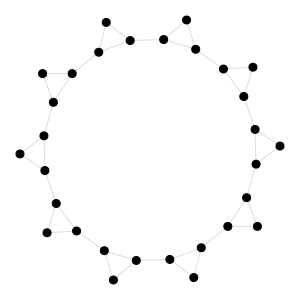

In [114]:
## n cliques of size s
def ringOfCliques(n,s):
    roc =  ig.Graph.Erdos_Renyi(n=n*s,p=0)
    ## cliques
    for i in range(n):
        for j in np.arange(s*i,s*(i+1)):
            for k in np.arange(j+1,s*(i+1)):
                roc.add_edge(j,k)
    ## ring
    for i in range(n):
        if i>0:
            roc.add_edge(s*i-1,s*i)
        else:
            roc.add_edge(n*s-1,0)
    roc.vs['size'] = 8
    roc.vs['color'] = cls[2]
    roc.es['color'] = cls_edges
    return roc
roc = ringOfCliques(10,3)
ig.plot(roc,'ring_3.eps',bbox=(0,0,300,300))

In [211]:
roc.write_edgelist("roc.edgelist")

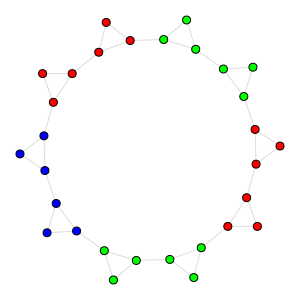

In [212]:
## Louvain communities with 10 3-cliques

roc = ringOfCliques(n=10,s=3)
roc.vs['ml'] = roc.community_multilevel().membership
roc.vs['color'] = [cls[x%3] for x in roc.vs['ml']]
ig.plot(roc,'ring_3_q.eps', bbox=(0,0,300,300))

In [213]:
with open('ring_3.ecg', 'w') as f:
    for item in roc.vs['ml']:
      f.write("%s\n" % item)

In [214]:
file = open('ring_3.ecg', 'r') 


In [ ]:
L3 = []
L_Net3 = []
DIM = [4,8,16,32,64,128]

REP = 30

## node2vec is in my path
for dim in DIM:
    for (p,q) in [(1,0),(1,.5),(0,1),(.5,1),(1,1)]:
      div = []
      for rep in range(REP):
                ## generate new degree and community size values
        x = 'snap/examples/node2vec/node2vec -i:roc.edgelist -o:_embed -d:'+str(dim)+' -p:'+str(p)+' -q:'+str(q)
        r = os.system(x)
        jsd = JS('roc.edgelist','ring_3.ecg','_embed')
        L3.append([dim,'n2v',str(p)+' '+str(q),jsd])
        div.append(jsd)
      L_Net3.append([dim,'n2v',str(p)+' ' + str(q),np.mean(div),np.std(div)])
    print(dim)


**Quality of each embedding by computing the divergence score**

In [280]:
D3 = pd.DataFrame(L_Net3,columns=['dim','algo','param','Mean divergence score', 'Std divergence score'])
D3 = D3.sort_values(by='Mean divergence score',axis=0)
D3.head(10)

,dim,algo,param,Mean divergence score,Std divergence score
25,128,n2v,1 0,0.000090,0.000039
26,128,n2v,1 0.5,0.000093,0.000033
21,64,n2v,1 0.5,0.000101,0.000048
16,32,n2v,1 0.5,0.000102,0.000039
15,32,n2v,1 0,0.000106,0.000047
10,16,n2v,1 0,0.000109,0.000051
11,16,n2v,1 0.5,0.000109,0.000051
20,64,n2v,1 0,0.000115,0.000053
19,32,n2v,1 1,0.000137,0.000057
6,8,n2v,1 0.5,0.000155,0.000061


**Best embedding for Node2vec**

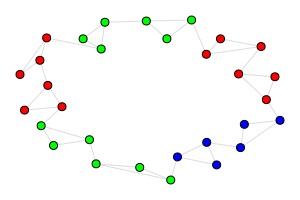

In [285]:
dim, algo, param, mean_div,std_div = D3.iloc[0]
s = param.split()
p = float(s[0])
q = float(s[1])
x = 'snap/examples/node2vec/node2vec -i:roc.edgelist -o:_embed -d:'+str(dim)+' -p:'+str(p)+' -q:'+str(q)
r = os.system(x)

roc.vs['name'] = [str(i) for i in range(roc.vcount())]
l = embed2layout()
roc.vs['ly'] = [l[int(v['name'])] for v in roc.vs]

#ig.plot(z, 'zac_high.eps', layout=z.vs['ly'], bbox=(0,0,300,200))
ig.plot(roc,layout=roc.vs['ly'], bbox=(0,0,300,200))

**Worst embedding for Node2vec**

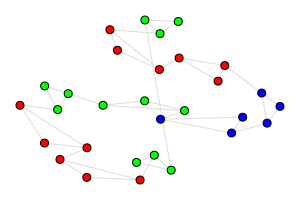

In [286]:
dim, algo, param, mean_div,std_div = D3.iloc[-1]
s = param.split()
p = float(s[0])
q = float(s[1])
x = 'snap/examples/node2vec/node2vec -i:roc.edgelist -o:_embed -d:'+str(dim)+' -p:'+str(p)+' -q:'+str(q)
r = os.system(x)

roc.vs['name'] = [str(i) for i in range(roc.vcount())]
l = embed2layout()
roc.vs['ly'] = [l[int(v['name'])] for v in roc.vs]

#ig.plot(z, 'zac_high.eps', layout=z.vs['ly'], bbox=(0,0,300,200))
ig.plot(roc,layout=roc.vs['ly'], bbox=(0,0,300,200))

In [ ]:
L4 = []
L_Net4 = []
DIM = [4,8,16,32,64,128]

REP = 30

## node2vec is in my path
for dim in DIM:
    div = []
    for rep in range(REP):
            ## generate new degree and community size values
      X = LE(roc,dim=dim)
      saveEmbedding(X,roc)       
      jsd = JS('roc.edgelist','ring_3.ecg','_embed')
      L4.append([dim,'le',' ',jsd])
      div.append(jsd)
    L_Net4.append([dim,'le',' ',np.mean(div),np.std(div)])
    print(dim)

In [288]:
D4 = pd.DataFrame(L_Net4,columns=['dim','algo','param','Mean divergence score', 'Std divergence score'])
D4 = D2.sort_values(by='Mean divergence score',axis=0)
D4.head(10)

,dim,algo,param,Mean divergence score,Std divergence score
5,128,le,,0.000682,0.000000e+00
4,64,le,,0.000787,1.084202e-19
3,32,le,,0.000845,1.084202e-19
2,16,le,,0.000903,0.000000e+00
1,8,le,,0.000940,1.084202e-19
0,4,le,,0.000955,0.000000e+00


**Best embedding for Laplacian Eigenmaps**

/usr/local/lib/python3.6/dist-packages/scipy/sparse/linalg/eigen/arpack/arpack.py:1269: RuntimeWarning: k >= N - 1 for N * N square matrix. Attempting to use scipy.linalg.eig instead.
  RuntimeWarning)


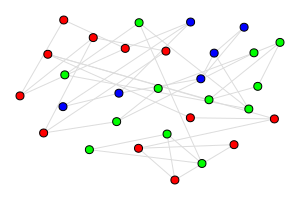

In [289]:
dim, algo, param, mean_div,std_div = D4.iloc[0]
X = LE(roc,dim=dim)
saveEmbedding(X,roc)

roc.vs['name'] = [str(i) for i in range(roc.vcount())]
l = embed2layout()
roc.vs['ly'] = [l[int(v['name'])] for v in roc.vs]

#ig.plot(z, 'zac_high.eps', layout=z.vs['ly'], bbox=(0,0,300,200))
ig.plot(roc,layout=roc.vs['ly'], bbox=(0,0,300,200))

**Worst embedding for Laplacian Eigenmaps**

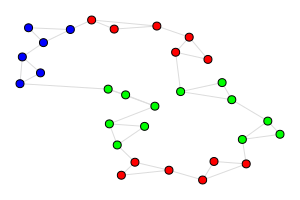

In [291]:
dim, algo, param, mean_div,std_div = D4.iloc[-1]
X = LE(roc,dim=dim)
saveEmbedding(X,roc)

roc.vs['name'] = [str(i) for i in range(roc.vcount())]
l = embed2layout()
roc.vs['ly'] = [l[int(v['name'])] for v in roc.vs]

#ig.plot(z, 'zac_high.eps', layout=z.vs['ly'], bbox=(0,0,300,200))
ig.plot(roc,layout=roc.vs['ly'], bbox=(0,0,300,200))

# Problem 3

The graph was very big so I write the code and plot the best and work embeddings ***using parameters and dimensions from previous problem***

In [257]:
## read edge list for the grid network
gr = ig.Graph.Read_Ncol(datadir+'GridEurope/gridkit_europe-highvoltage.edges', directed=False)
gr = gr.simplify()

## read the vertices along with some attributes
X = pd.read_csv(datadir+'GridEurope/gridkit_europe-highvoltage.vertices')
idx = [int(i) for i in gr.vs['name']]
sorterIndex = dict(zip(idx,range(len(idx))))
X['Rank'] = X['v_id'].map(sorterIndex)
X.sort_values(['Rank'], ascending=[True],inplace=True)
X.dropna(inplace=True)
gr.vs['longitude'] = list(X['lon'])
gr.vs['latitude'] = list(X['lat'])
gr.vs['type'] = list(X['typ'])
gr.vs['layout'] = [(v['longitude'],v['latitude']) for v in gr.vs()]
gr.vs['size'] = 3
gr.es['color'] = 'grey'
gr.vs['color'] = 'black'

1562 nodes


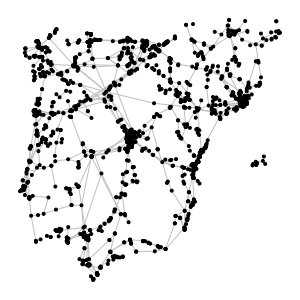

In [183]:
## subgraph of Grid -- Iberic peninsula
V = [v for v in gr.vs() if v['latitude']>36 and v['latitude']<44 and v['longitude']>-10 and v['longitude']<4]
gr_spain = gr.subgraph(V)
ly = ig.Layout(gr_spain.vs['layout'])
ly.mirror(1)
print(gr_spain.vcount(),'nodes')
ig.plot(gr_spain, 'grid_sg.eps', layout=ly, bbox=(0,0,300,300))

In [199]:
cls = ['gold','yellowgreen','darkblue','green','red','blue','limegreen','lime','lightgray','aqua','yellow','magenta']

In [308]:
max(gr.vs['ml'])

130

Max value of labelling was 130 so I added some more colors 

In [307]:
gr.vs['ml'] = gr.community_multilevel().membership
gr.vs['color'] = [cls[x%8] for x in gr.vs['ml']]
ig.plot(gr,'ring_3_q.eps', bbox=(0,0,600,600))

In [272]:
gr.write_edgelist("gr.edgelist")

In [262]:
min(gr.vs['ml'])

0

In [273]:
with open('gr_f.ecg', 'w') as f:
    for item in gr.vs['ml']:
      f.write("%s\n" % item)

In [274]:
file = open('gr_f.ecg','r')

In [ ]:
L5 = []
L_Net5 = []
DIM = [4,8,16,32,64,128]

REP = 1

## node2vec is in my path
for dim in DIM:
    for (p,q) in [(1,0),(1,.5),(0,1),(.5,1),(1,1)]:
      div = []
      for rep in range(REP):
                ## generate new degree and community size values
        x = 'snap/examples/node2vec/node2vec -i:gr.edgelist -o:_embed -d:'+str(dim)+' -p:'+str(p)+' -q:'+str(q)
       # print(x)
        r = os.system(x)
        jsd = JS('gr.edgelist','gr_f.ecg','_embed')
        L5.append([dim,'n2v',str(p)+' '+str(q),jsd])
        div.append(jsd)
      L_Net5.append([dim,'n2v',str(p)+' ' + str(q),np.mean(div),np.std(div)])
    print(dim)


In [ ]:
L6 = []
L_Net6 = []
DIM = [4,8,16,32,64,128]

REP = 1

## node2vec is in my path
for dim in DIM:
    div = []
    for rep in range(REP):
            ## generate new degree and community size values
      X = LE(gr,dim=dim)
      saveEmbedding(X,gr)       
      jsd = JS('gr.edgelist','gr_f.ecg','_embed')
      L6.append([dim,'le',' ',jsd])
      div.append(jsd)
    L_Net6.append([dim,'le',' ',np.mean(div),np.std(div)])
    print(dim)

## **Best Embedding for the graph using Node2vec**

In [309]:
dim, algo, param, mean_div,std_div = D.iloc[0]
s = param.split()
p = float(s[0])
q = float(s[1])
x = 'snap/examples/node2vec/node2vec -i:gr.edgelist -o:_embed -d:'+str(dim)+' -p:'+str(p)+' -q:'+str(q)
r = os.system(x)

gr.vs['name'] = [str(i) for i in range(gr.vcount())]
l = embed2layout()
gr.vs['ly'] = [l[int(v['name'])] for v in gr.vs]

#ig.plot(z, 'zac_high.eps', layout=z.vs['ly'], bbox=(0,0,300,200))
ig.plot(gr,layout=gr.vs['ly'], bbox=(0,0,600,600))

## **Worst Embedding for the graph using Node2vec**

In [277]:
dim, algo, param, mean_div,std_div = D.iloc[-1]
s = param.split()
p = float(s[0])
q = float(s[1])
x = 'snap/examples/node2vec/node2vec -i:gr.edgelist -o:_embed -d:'+str(dim)+' -p:'+str(p)+' -q:'+str(q)
r = os.system(x)

gr.vs['name'] = [str(i) for i in range(gr.vcount())]
l = embed2layout()
gr.vs['ly'] = [l[int(v['name'])] for v in gr.vs]

#ig.plot(z, 'zac_high.eps', layout=z.vs['ly'], bbox=(0,0,300,200))
ig.plot(gr,layout=gr.vs['ly'], bbox=(0,0,600,600))